In [1]:
import os, random
import cv2
import math
import librosa
import matplotlib.pyplot as plt
font = {'size'   : 5}
plt.rc('font', **font)

import numpy as np
import pandas as pd
from tqdm import tqdm

from collections import Counter

import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import WeightedRandomSampler
from torchvision.models import efficientnet
from torchvision.transforms import transforms

import tensorflow_hub as hub

import timm

import albumentations as albu

import scikitplot as skplt
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit, KFold
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.preprocessing import LabelEncoder

from glob import glob
from IPython.display import display, Audio

import cupy as cp
from cupyx.scipy import signal as cupy_signal
import yaml

from metric import score

import wandb

import plotly.graph_objects as go
import plotly.express as px

c:\Users\hoang\anaconda3\envs\bird\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\hoang\anaconda3\envs\bird\lib\site-packages\cupyx\jit\_interface.py:173: FutureWarning: cupyx.jit.rawkernel is experimental. The interface can change in the future.
  cupy._util.experimental('cupyx.jit.rawkernel')


In [2]:
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


wandb: Currently logged in as: lhk. Use `wandb login --relogin` to force relogin


True

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cuda


In [4]:
default_config = {
    "VERSION": "v0.3",
    "DATA_PATH": "inputs",
    "LOAD_SPEC_DATA": True,
    "SEED": 24,
    "SAMPLE_RATE": 32000,
    "N_FFT": 1095,
    "WIN_SIZE": 412,
    "WIN_LAP": 100,
    "MIN_FREQ": 40,
    "MAX_FREQ": 15000,
    "EPOCHS": 10,
    "BACHSIZE": 16
}

try:
    with open('config.yaml', 'r') as f:
        default_config = yaml.load(f, Loader=yaml.SafeLoader)
except:
    pass

default_config

{'VERSION': 'v1.7',
 'DESCRIPTION': 'First 5s with 21-22-23-24',
 'DATA_PATH': 'inputs',
 'LOAD_SPEC_DATA': ['data/spec_first_5sec_256_256_24.npy',
  'data/spec_first_5sec_256_256_212223.npy'],
 'SEED': 24,
 'SAMPLE_RATE': 32000,
 'N_FFT': 1024,
 'WIN_SIZE': 412,
 'WIN_LAP': 100,
 'MIN_FREQ': 40,
 'MAX_FREQ': 15000,
 'N_MEL': 128,
 'HOP_LENGTH': 320,
 'XYMasking': True,
 'EPOCHS': 10,
 'FOLD': 5,
 'BACTHSIZE': 16,
 'LABEL_SMOOTHING': 0.0}

In [5]:
# Reproducibility
torch.manual_seed(default_config["SEED"])
random.seed(default_config["SEED"])
np.random.seed(default_config["SEED"])

In [7]:
if default_config["LOAD_SPEC_DATA"]:
        all_bird_data = dict()
        for data_path in default_config["LOAD_SPEC_DATA"]:
                all_bird_data.update(np.load(data_path, allow_pickle=True).item())
len(all_bird_data)

26571

In [8]:
meta_data = pd.DataFrame(all_bird_data.items(), columns=["filename","audioarray"])
del all_bird_data

def drop_startidx(x):
    return x.split("_")[0]

def get_primary_label(x):
    return x.split("/")[0]

meta_data["filename"] = meta_data["filename"]
meta_data['primary_label'] = meta_data["filename"].apply(drop_startidx).apply(get_primary_label)

label_list = sorted(meta_data["primary_label"].unique())
label_id_list = list(range(len(label_list)))
label2id = dict(zip(label_list, label_id_list))
id2label = dict(zip(label_id_list, label_list))

class_weights = meta_data.groupby(["primary_label"]).size().to_dict()
class_weights = dict((label2id[label], (num/len(meta_data))**(-0.5)) for (label, num) in class_weights.items())
class_weights

meta_data

,filename,audioarray,primary_label
0,asbfly/XC134896.ogg_0,"[[0.10956176, 0.2377826, 0.26634425, 0.2611969...",asbfly
1,asbfly/XC164848.ogg_0,"[[0.17956369, 0.24214461, 0.670926, 0.8550604,...",asbfly
2,asbfly/XC175797.ogg_0,"[[0.29080734, 0.3808823, 0.44355923, 0.4777059...",asbfly
3,asbfly/XC207738.ogg_0,"[[0.3157267, 0.7882964, 0.80517566, 0.76346457...",asbfly
4,asbfly/XC209218.ogg_0,"[[0.88251305, 0.9407033, 0.8528946, 0.87259686...",asbfly
...,...,...,...
26566,woosan/XC431213.ogg_0,"[[0.13285282, 0.21309787, 0.26674017, 0.389913...",woosan
26567,woosan/XC133322.ogg_0,"[[0.1110103, 0.14650732, 0.5078068, 0.5426778,...",woosan
26568,woosan/XC203978.ogg_0,"[[0.47948205, 0.52830064, 0.8064898, 0.9383898...",woosan
26569,woosan/XC580253.ogg_0,"[[0.03196865, 0.3553304, 0.7935965, 0.9348828,...",woosan


In [9]:
bird_transforms_albu = albu.Compose([
    albu.XYMasking(p=0.3, num_masks_x=(1,3), num_masks_y=(1,3), mask_x_length=(1,10), mask_y_length=(1,10)) if default_config["XYMasking"] else albu.NoOp()
])

In [10]:
class BirdCLEF_Dataset(torch.utils.data.Dataset):
    def __init__(self, df_data, bird_transforms=False):
        super(BirdCLEF_Dataset).__init__()
        self.df_data = df_data
        self.bird_transforms = bird_transforms

    def __len__(self):
        return len(self.df_data)
    
    def __getitem__(self, index):
        X = self.df_data.iloc[index].audioarray
        y = label2id[self.df_data.iloc[index].filename.split("/")[0]]
        
        if (self.bird_transforms):
            X = self.bird_transforms(image=X)["image"]

        X = np.array([X])
        return torch.tensor(X, dtype=torch.float32), torch.tensor(y, dtype=torch.long)
    
def display_batch (dataset, audio=False):
    fig = plt.figure(figsize=(15,10))
    img_index = np.random.randint(0, len(dataset)-1, 5*10)

    for i in range(len(img_index)):
        img, label = dataset[img_index[i]]
        
        if isinstance(img, torch.Tensor):
            img = img.detach().numpy()
        
        ax = fig.add_subplot(5, 10, i + 1, xticks=[], yticks=[])
        ax.imshow(np.squeeze(img), cmap='jet')
        ax.set_title(f'ID: {img_index[i]}; Target: {id2label[label.item()]}')

    plt.tight_layout()
    plt.show()

    if (audio):
        try:
            for i in range(len(img_index)):
                filepath = f"inputs/train_audio/{dataset.df_data.iloc[img_index[i]].filename}"[:-2]
                print(f"{img_index[i]} {filepath}")
                display(Audio(filepath))
        except:
            pass


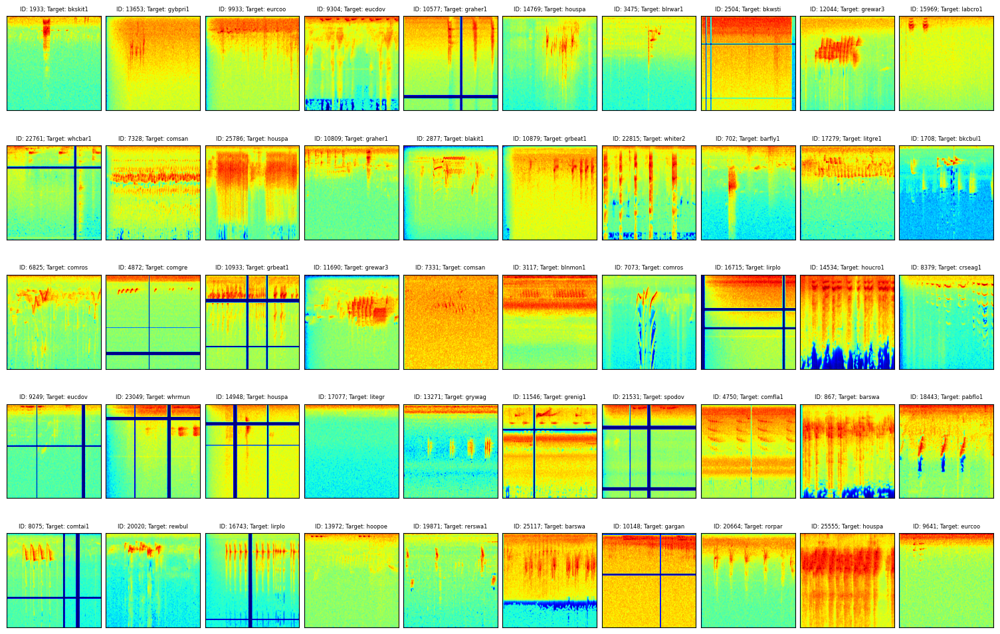

1933 inputs/train_audio/bkskit1/XC360638.ogg


13653 inputs/train_audio/gybpri1/XC775448.ogg


9933 inputs/train_audio/eurcoo/XC720887.ogg


9304 inputs/train_audio/eucdov/XC631398.ogg


10577 inputs/train_audio/graher1/XC570013.ogg


14769 inputs/train_audio/houspa/XC492128.ogg


3475 inputs/train_audio/blrwar1/XC575242.ogg


2504 inputs/train_audio/bkwsti/XC827771.ogg


12044 inputs/train_audio/grewar3/XC810786.ogg


15969 inputs/train_audio/labcro1/XC409277.ogg


22761 inputs/train_audio/whcbar1/XC545230.ogg


7328 inputs/train_audio/comsan/XC325200.ogg


25786 inputs/train_audio/houspa/XC436230.ogg


In [28]:
dataset = BirdCLEF_Dataset(meta_data, bird_transforms_albu)
display_batch(dataset, audio=True)

In [13]:
class BirdCLEF_Model_EfficientnetB0(nn.Module):
    def __init__(self, num_class):
        super(BirdCLEF_Model_EfficientnetB0, self).__init__()
        self.backbone = timm.create_model('tf_efficientnet_b0.in1k', pretrained=True, in_chans=1,  num_classes=num_class)
    
    def forward(self, x):
        x = self.backbone(x)
        return x

In [14]:
ssk = StratifiedKFold(n_splits=default_config["FOLD"], shuffle=True, random_state=default_config["SEED"])
meta_data['fold'] = 0
for fold, (train_idx, val_idx) in enumerate(ssk.split(np.zeros(len(meta_data)), meta_data["primary_label"].to_numpy())):
    meta_data.loc[val_idx, 'fold'] = fold

==== Running training for fold 0 ====
Train Samples: 21256
Valid Samples: 5315


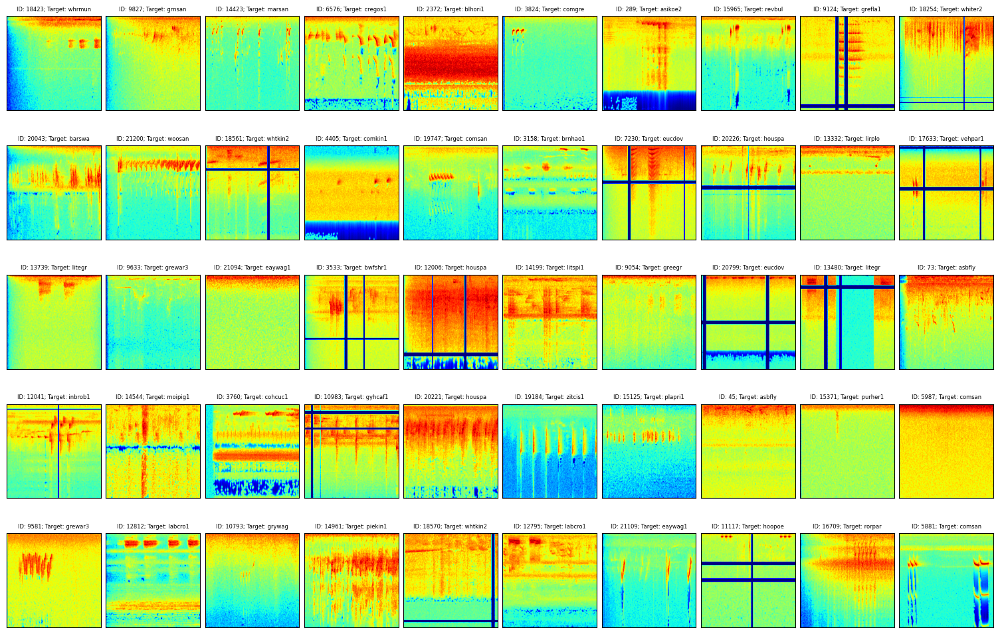

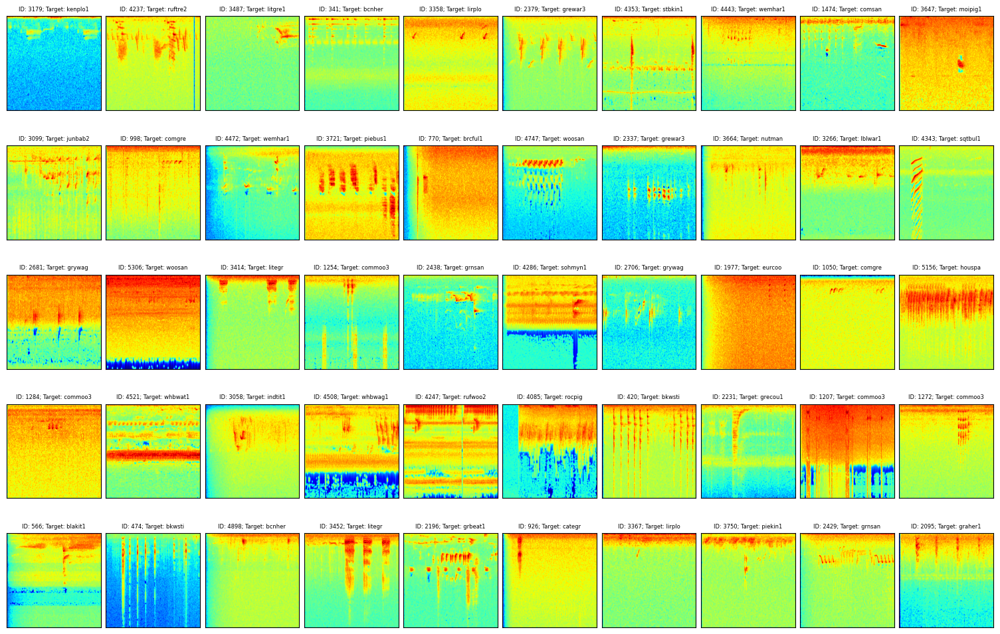

Epoch 1/10, train_loss: 4.7755, valid_loss: 4.2525 valid_roc_auc: 0.7194, lr: [4.7618567141402096e-05]
Epoch 2/10, train_loss: 0.5568, valid_loss: 2.2718 valid_roc_auc: 0.9218, lr: [0.00012923712583332524]
Epoch 3/10, train_loss: 1.7391, valid_loss: 2.0259 valid_roc_auc: 0.9400, lr: [0.00016999999515335856]
Epoch 4/10, train_loss: 0.9893, valid_loss: 1.9154 valid_roc_auc: 0.9381, lr: [0.00016156992883058135]
Epoch 5/10, train_loss: 0.2484, valid_loss: 1.9576 valid_roc_auc: 0.9376, lr: [0.00013797431637552665]
Epoch 6/10, train_loss: 0.3955, valid_loss: 2.0142 valid_roc_auc: 0.9346, lr: [0.00010388655821611411]
Epoch 7/10, train_loss: 0.5933, valid_loss: 2.0417 valid_roc_auc: 0.9392, lr: [6.605815291473412e-05]
Epoch 8/10, train_loss: 0.0037, valid_loss: 2.0210 valid_roc_auc: 0.9414, lr: [3.198148007627025e-05]
Epoch 9/10, train_loss: 0.0006, valid_loss: 2.0204 valid_roc_auc: 0.9415, lr: [8.405842679346385e-06]
Epoch 10/10, train_loss: 0.0006, valid_loss: 2.0343 valid_roc_auc: 0.9422, l

Learning Rate,▁▁▂▂▃▄▅▆▆▇███████▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training Loss,█▂▄▂▁▂▂▁▁▁
Valid Loss,█▂▁▁▁▁▁▁▁▁
Valid ROC_AUC,▁▇████████
Learning Rate,0.0
Training Loss,0.00065
Valid Loss,2.03432
Valid ROC_AUC,0.94224


==== Running training for fold 1 ====
Train Samples: 21257
Valid Samples: 5314


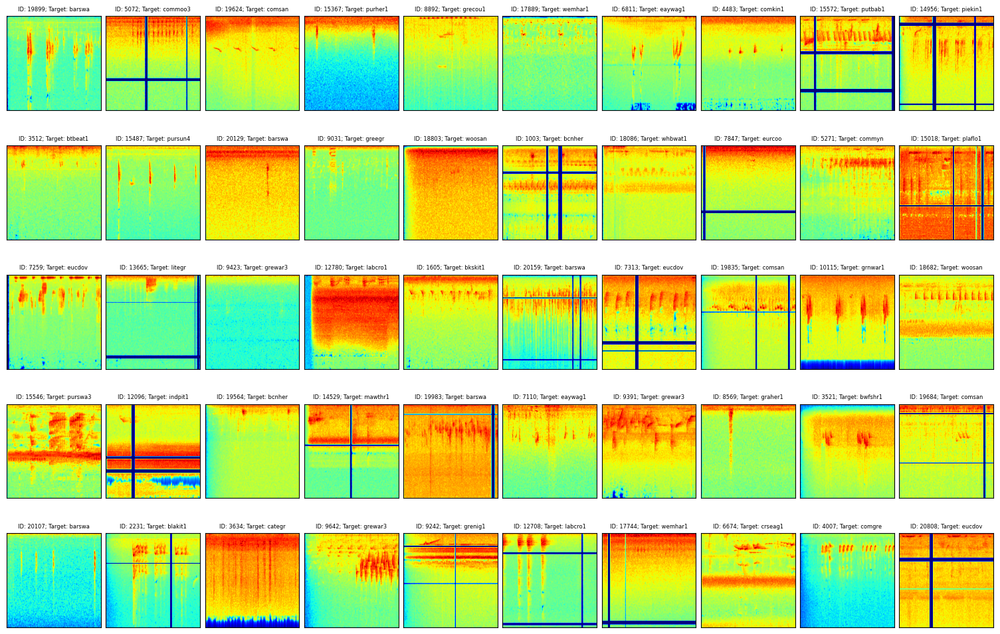

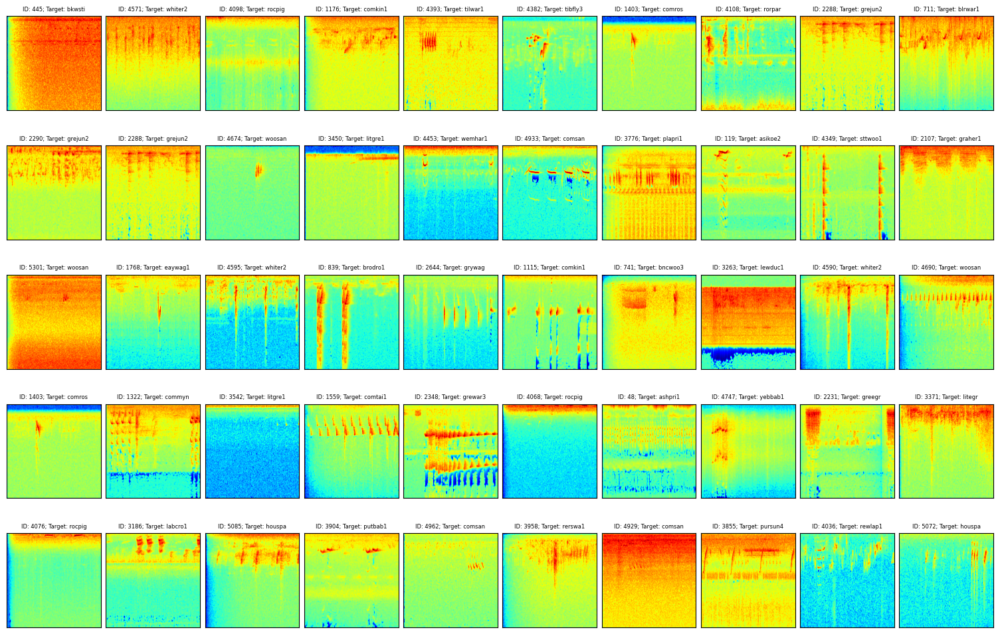

Epoch 1/10, train_loss: 4.5098, valid_loss: 4.3059 valid_roc_auc: 0.7242, lr: [4.7618567141402096e-05]
Epoch 2/10, train_loss: 3.0721, valid_loss: 2.3097 valid_roc_auc: 0.9261, lr: [0.00012923712583332524]
Epoch 3/10, train_loss: 1.5602, valid_loss: 1.9730 valid_roc_auc: 0.9451, lr: [0.00016999999515335856]
Epoch 4/10, train_loss: 0.6393, valid_loss: 1.9465 valid_roc_auc: 0.9448, lr: [0.00016156992883058135]
Epoch 5/10, train_loss: 0.1090, valid_loss: 1.9767 valid_roc_auc: 0.9423, lr: [0.00013797431637552665]
Epoch 6/10, train_loss: 0.5325, valid_loss: 1.8972 valid_roc_auc: 0.9425, lr: [0.00010388655821611411]
Epoch 7/10, train_loss: 0.1032, valid_loss: 1.9165 valid_roc_auc: 0.9424, lr: [6.605815291473412e-05]
Epoch 8/10, train_loss: 0.0335, valid_loss: 2.0229 valid_roc_auc: 0.9441, lr: [3.198148007627025e-05]
Epoch 9/10, train_loss: 0.0030, valid_loss: 1.9815 valid_roc_auc: 0.9459, lr: [8.405842679346385e-06]
Epoch 10/10, train_loss: 0.0853, valid_loss: 2.0058 valid_roc_auc: 0.9465, l

Learning Rate,▁▁▂▂▃▄▅▆▆▇███████▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training Loss,█▆▃▂▁▂▁▁▁▁
Valid Loss,█▂▁▁▁▁▁▁▁▁
Valid ROC_AUC,▁▇████████
Learning Rate,0.0
Training Loss,0.08526
Valid Loss,2.00583
Valid ROC_AUC,0.94648


==== Running training for fold 2 ====
Train Samples: 21257
Valid Samples: 5314


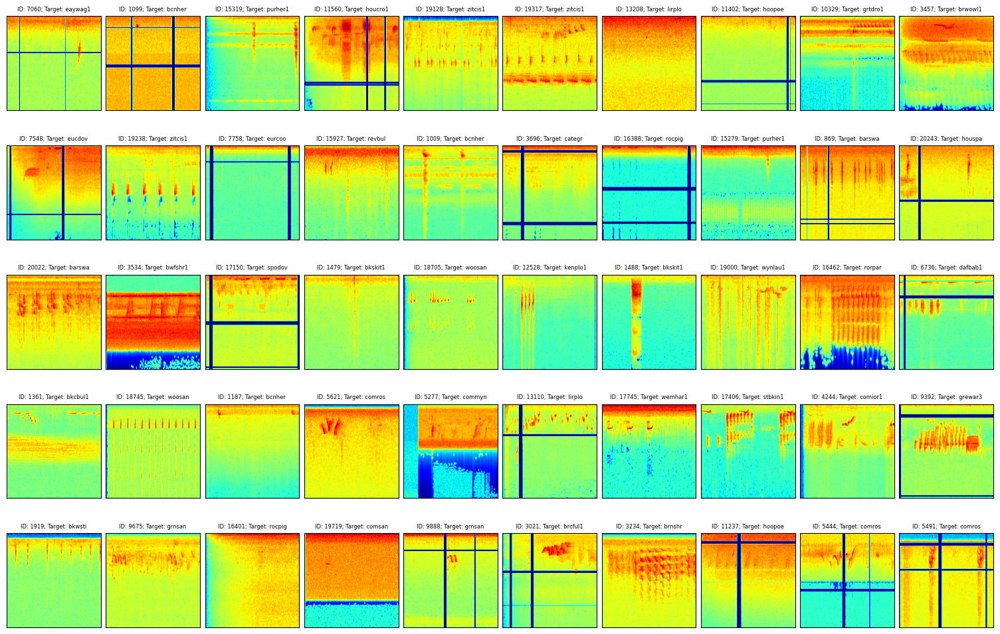

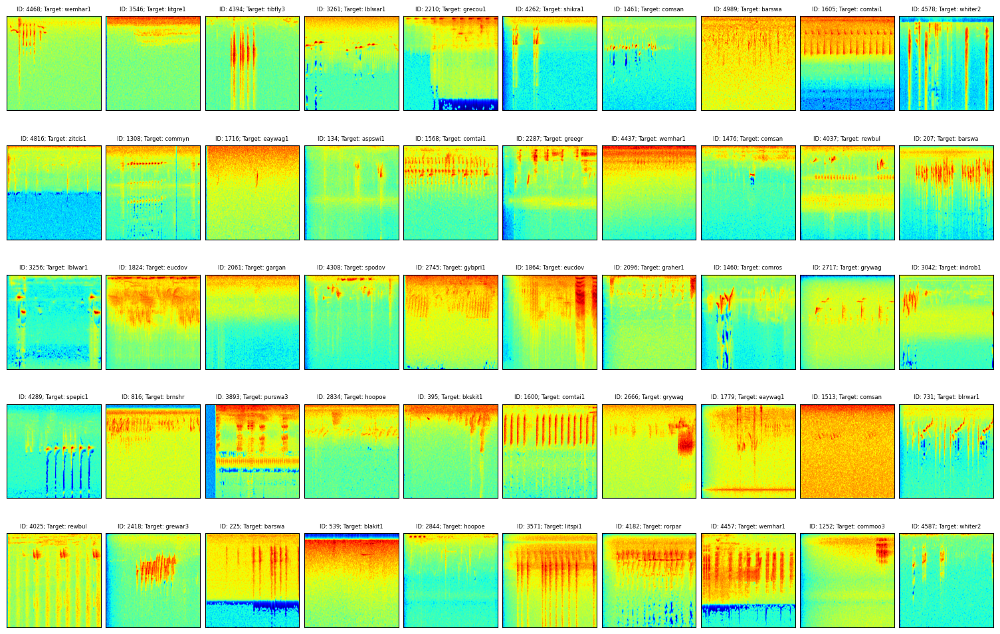

Epoch 1/10, train_loss: 4.7019, valid_loss: 4.3903 valid_roc_auc: 0.7160, lr: [4.7618567141402096e-05]
Epoch 2/10, train_loss: 2.0922, valid_loss: 2.2801 valid_roc_auc: 0.9239, lr: [0.00012923712583332524]
Epoch 3/10, train_loss: 1.2602, valid_loss: 2.0247 valid_roc_auc: 0.9302, lr: [0.00016999999515335856]
Epoch 4/10, train_loss: 0.1277, valid_loss: 1.7761 valid_roc_auc: 0.9353, lr: [0.00016156992883058135]
Epoch 5/10, train_loss: 0.5811, valid_loss: 1.8223 valid_roc_auc: 0.9277, lr: [0.00013797431637552665]
Epoch 6/10, train_loss: 0.3573, valid_loss: 1.8305 valid_roc_auc: 0.9376, lr: [0.00010388655821611411]
Epoch 7/10, train_loss: 0.1283, valid_loss: 1.9269 valid_roc_auc: 0.9387, lr: [6.605815291473412e-05]
Epoch 8/10, train_loss: 0.0982, valid_loss: 1.9036 valid_roc_auc: 0.9386, lr: [3.198148007627025e-05]
Epoch 9/10, train_loss: 0.4529, valid_loss: 1.9697 valid_roc_auc: 0.9380, lr: [8.405842679346385e-06]
Epoch 10/10, train_loss: 0.0020, valid_loss: 1.9399 valid_roc_auc: 0.9381, l

Learning Rate,▁▁▂▂▃▄▅▆▆▇███████▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training Loss,█▄▃▁▂▂▁▁▂▁
Valid Loss,█▂▂▁▁▁▁▁▂▁
Valid ROC_AUC,▁█████████
Learning Rate,0.0
Training Loss,0.00197
Valid Loss,1.93986
Valid ROC_AUC,0.93814


==== Running training for fold 3 ====
Train Samples: 21257
Valid Samples: 5314


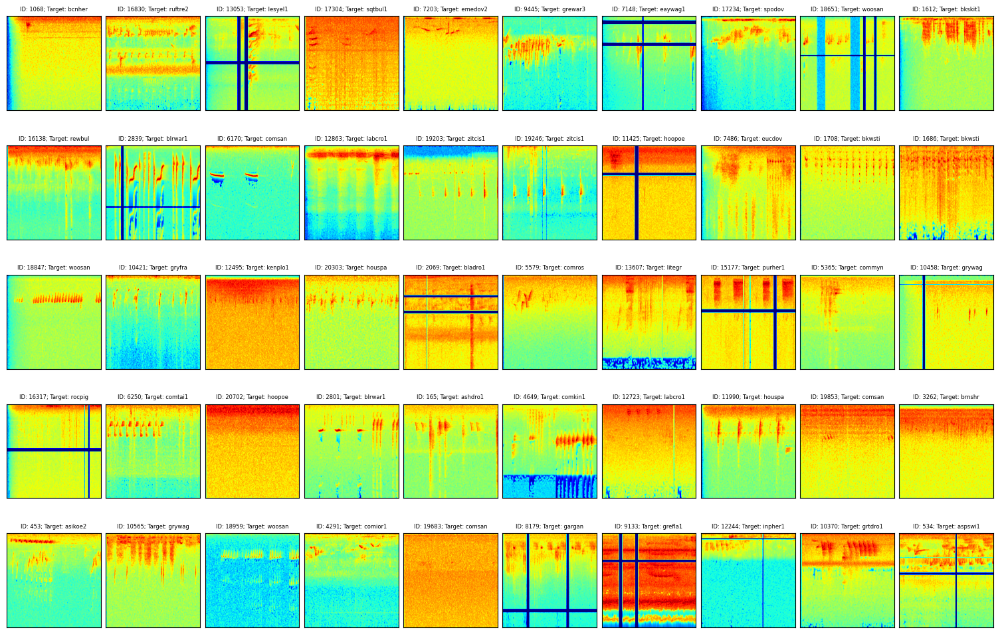

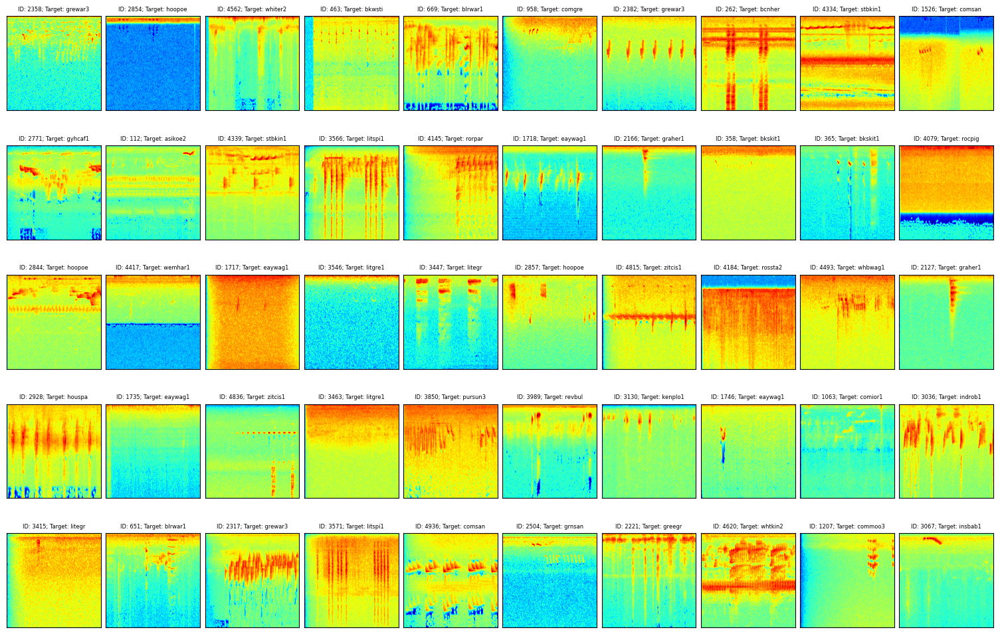

Epoch 1/10, train_loss: 5.4035, valid_loss: 4.3278 valid_roc_auc: 0.7248, lr: [4.7618567141402096e-05]
Epoch 2/10, train_loss: 1.8484, valid_loss: 2.3799 valid_roc_auc: 0.9201, lr: [0.00012923712583332524]
Epoch 3/10, train_loss: 1.0140, valid_loss: 1.9751 valid_roc_auc: 0.9308, lr: [0.00016999999515335856]
Epoch 4/10, train_loss: 0.9754, valid_loss: 1.8582 valid_roc_auc: 0.9388, lr: [0.00016156992883058135]
Epoch 5/10, train_loss: 0.1099, valid_loss: 1.7844 valid_roc_auc: 0.9390, lr: [0.00013797431637552665]
Epoch 6/10, train_loss: 0.5040, valid_loss: 1.8200 valid_roc_auc: 0.9386, lr: [0.00010388655821611411]
Epoch 7/10, train_loss: 0.0038, valid_loss: 1.9700 valid_roc_auc: 0.9383, lr: [6.605815291473412e-05]
Epoch 8/10, train_loss: 0.0110, valid_loss: 1.9067 valid_roc_auc: 0.9333, lr: [3.198148007627025e-05]
Epoch 9/10, train_loss: 0.0106, valid_loss: 1.9824 valid_roc_auc: 0.9359, lr: [8.405842679346385e-06]
Epoch 10/10, train_loss: 0.0037, valid_loss: 1.9642 valid_roc_auc: 0.9359, l

Learning Rate,▁▁▂▂▃▄▅▆▆▇███████▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training Loss,█▃▂▂▁▂▁▁▁▁
Valid Loss,█▃▂▁▁▁▂▁▂▁
Valid ROC_AUC,▁▇████████
Learning Rate,0.0
Training Loss,0.00368
Valid Loss,1.96422
Valid ROC_AUC,0.93593


==== Running training for fold 4 ====
Train Samples: 21257
Valid Samples: 5314


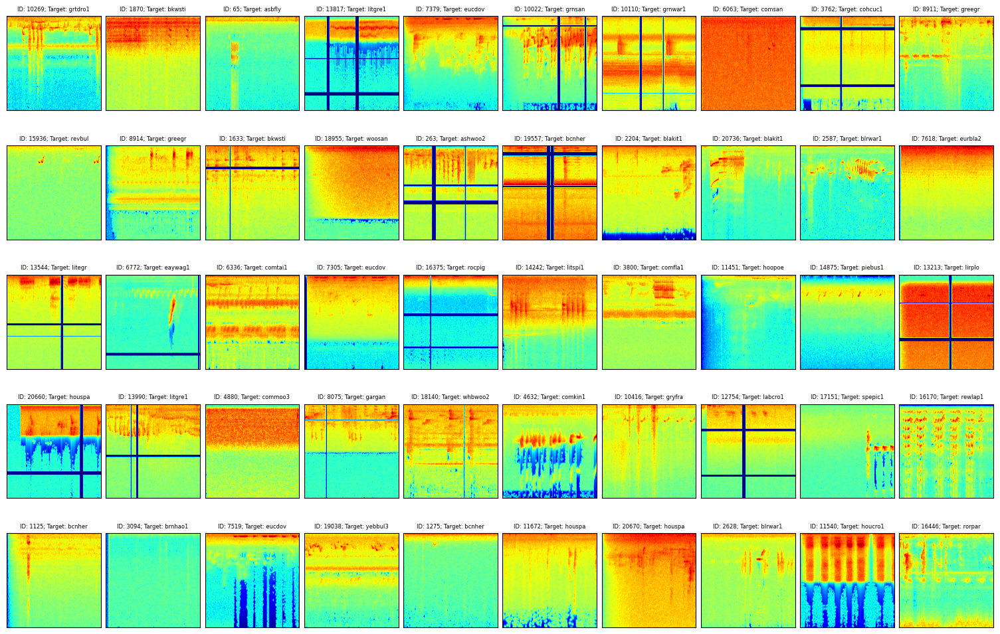

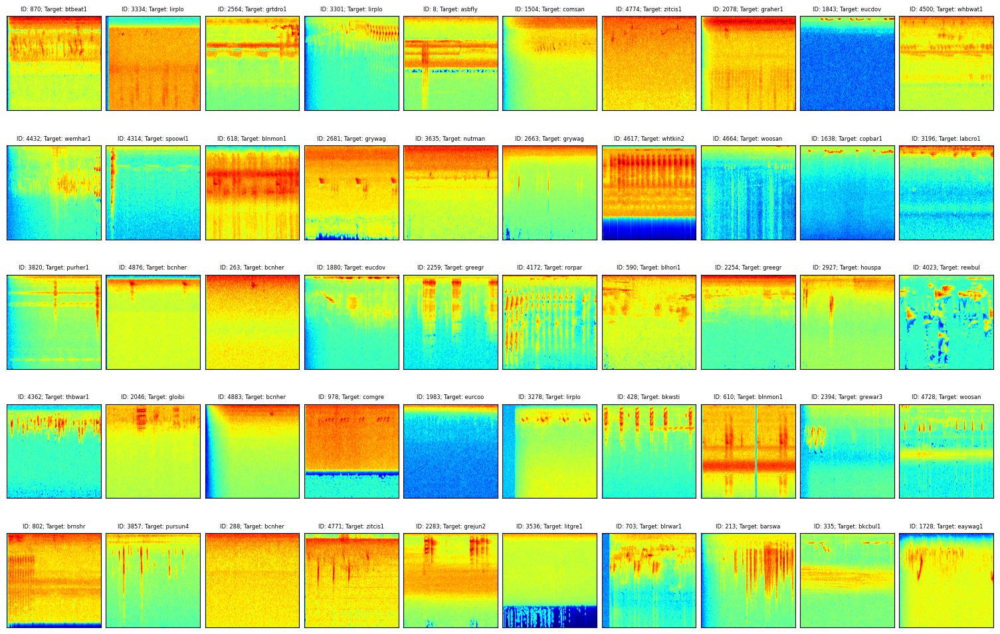

Epoch 1/10, train_loss: 4.6730, valid_loss: 4.2157 valid_roc_auc: 0.7289, lr: [4.7618567141402096e-05]
Epoch 2/10, train_loss: 1.3179, valid_loss: 2.2264 valid_roc_auc: 0.9257, lr: [0.00012923712583332524]
Epoch 3/10, train_loss: 1.4394, valid_loss: 2.0024 valid_roc_auc: 0.9372, lr: [0.00016999999515335856]
Epoch 4/10, train_loss: 0.2009, valid_loss: 1.9324 valid_roc_auc: 0.9410, lr: [0.00016156992883058135]
Epoch 5/10, train_loss: 0.0813, valid_loss: 1.9483 valid_roc_auc: 0.9435, lr: [0.00013797431637552665]
Epoch 6/10, train_loss: 0.1160, valid_loss: 1.9150 valid_roc_auc: 0.9408, lr: [0.00010388655821611411]
Epoch 7/10, train_loss: 0.0844, valid_loss: 1.9696 valid_roc_auc: 0.9405, lr: [6.605815291473412e-05]
Epoch 8/10, train_loss: 0.0070, valid_loss: 2.0114 valid_roc_auc: 0.9392, lr: [3.198148007627025e-05]
Epoch 9/10, train_loss: 0.0008, valid_loss: 2.0549 valid_roc_auc: 0.9407, lr: [8.405842679346385e-06]
Epoch 10/10, train_loss: 0.0156, valid_loss: 2.0233 valid_roc_auc: 0.9411, l

Learning Rate,▁▁▂▂▃▄▅▆▆▇███████▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training Loss,█▃▃▁▁▁▁▁▁▁
Valid Loss,█▂▁▁▁▁▁▁▁▁
Valid ROC_AUC,▁▇████████
Learning Rate,0.0
Training Loss,0.0156
Valid Loss,2.02326
Valid ROC_AUC,0.94114


In [16]:
if not os.path.exists(f"model/{default_config['VERSION']}"):
    os.makedirs(f"model/{default_config['VERSION']}")

for f in range(default_config["FOLD"]):
    run = wandb.init(project="BirdCLEF2024_LeviKaay", name=f"BaseModel_EfficientB0_Fold{f}_{default_config['VERSION']}", entity="Kaay", config=default_config)
    
    # main loop of f-fold
    print('================================================================')
    print(f"==== Running training for fold {f} ====")
    
    train_df = meta_data[meta_data['fold'] != f].copy().reset_index(drop=True)
    valid_df = meta_data[meta_data['fold'] == f].copy().reset_index(drop=True)
    
    print(f'Train Samples: {len(train_df)}')
    display_batch(train_dataset)

    print(f'Valid Samples: {len(valid_df)}')
    display_batch(valid_dataset)

    train_dataset = BirdCLEF_Dataset(train_df, bird_transforms=bird_transforms_albu)
    valid_dataset = BirdCLEF_Dataset(valid_df)


    #-------------Over sampling---------------
    sample_weights = [0] * len(train_dataset)
    for idx, (data, label) in enumerate(train_dataset):
        sample_weights[idx] = class_weights[label.item()]

    sampler = WeightedRandomSampler(sample_weights, num_samples=len(train_dataset), replacement=True)

    train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=default_config["BACTHSIZE"], sampler=sampler)
    valid_dataloader = torch.utils.data.DataLoader(valid_dataset, batch_size=default_config["BACTHSIZE"], shuffle=True)

    model = BirdCLEF_Model_EfficientnetB0(num_class=len(label_list)).to(device)
    criterion = nn.CrossEntropyLoss(label_smoothing=default_config["LABEL_SMOOTHING"])
    # criterion = nn.BCEWithLogitsLoss(reduction='sum')
    optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-3, weight_decay=1e-5)
    scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.00017, steps_per_epoch=len(train_dataloader), epochs=default_config["EPOCHS"], anneal_strategy='cos')

    # Training loop
    for epoch in range(default_config["EPOCHS"]):
        for idx,batch in enumerate(train_dataloader):
            inputs, targets = batch

            inputs = inputs.to(device)
            targets = targets.to(device)
            # targets = torch.nn.functional.one_hot(targets, len(label_list)).to(device).float()
            optimizer.zero_grad()
            # Forward pass
            outputs = model(inputs)
            
            # Compute loss
            loss = criterion(outputs, targets)
            
            # Backward pass and optimization
            loss.backward()
            optimizer.step()
            scheduler.step()
            print(f'Step {idx}/{len(train_dataloader)}, Loss: {loss.item():.4f}\r', end='', flush=True)
            wandb.log({"Learning Rate": scheduler.get_last_lr()[0]})
        model.eval()
        valid_step = []
        with torch.no_grad():
            for idx, batch in enumerate(valid_dataloader):
                inputs, targets = batch
                inputs = inputs.to(device)

                outputs = model(inputs)
                valid_step.append({"logits": outputs, "targets": targets})
            
            output_val = torch.cat([x['logits'] for x in valid_step], dim=0).cpu().detach()
            target_val = torch.cat([x['targets'] for x in valid_step], dim=0).cpu().detach()

            val_loss = criterion(output_val, target_val)
            target_val = torch.nn.functional.one_hot(target_val, len(label_list))
            
            gt_df = pd.DataFrame(target_val.numpy().astype(np.float32), columns=label_list)
            pred_df = pd.DataFrame(output_val.numpy().astype(np.float32), columns=label_list)
            
            gt_df['id'] = [f'id_{i}' for i in range(len(gt_df))]
            pred_df['id'] = [f'id_{i}' for i in range(len(pred_df))]

            val_roc_auc = score(gt_df, pred_df, row_id_column_name='id')
        
        print(f"Epoch {epoch+1}/{default_config['EPOCHS']}, train_loss: {loss.item():.4f}, valid_loss: {val_loss:.4f} valid_roc_auc: {val_roc_auc:.4f}, lr: {scheduler.get_last_lr()}")
        wandb.log({"Training Loss": loss.item(),"Valid Loss": val_loss ,"Valid ROC_AUC": val_roc_auc})
    run.finish()
    torch.save(model.state_dict(), f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold{f}.pt")


In [17]:
input_tensor = torch.randn(default_config["BACTHSIZE"], 1, 256, 256)

### Export model to ONNX

In [18]:
  # input shape
input_names = ['x']
output_names = ['output']

for fold in range(default_config["FOLD"]):
    bird_model = BirdCLEF_Model_EfficientnetB0(num_class=len(label_list))
    weights = torch.load(f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold{fold}.pt", map_location=torch.device('cpu'))
    bird_model.load_state_dict(weights)
    bird_model.eval()

    torch.onnx.export(bird_model, input_tensor, f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold{fold}.onnx", input_names=input_names, output_names=output_names)

### Export model to OpenVino

In [20]:
from openvino.runtime import Core
import openvino as ov

In [21]:
for fold in range(default_config["FOLD"]):
    bird_model = BirdCLEF_Model_EfficientnetB0(num_class=len(label_list))
    weights = torch.load(f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold{fold}.pt", map_location=torch.device('cpu'))
    bird_model.load_state_dict(weights)
    bird_model.eval()

    ov_model = ov.convert_model(bird_model, example_input=input_tensor)
    ov.save_model(ov_model, f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold{fold}.xml")

[ WARNING ]  From %s: The name %s is deprecated. Please use %s instead.



In [22]:
ie = Core()
classification_model_xml = f"model/v0.4/BaseModel_EfficientB0_Fold0.xml"
model = ie.read_model(model=classification_model_xml)

### PLot the ROC curve for each class

In [23]:
valid_df = meta_data[meta_data['fold'] == 0].copy()
valid_dataset = BirdCLEF_Dataset(valid_df)
valid_dataloader = torch.utils.data.DataLoader(valid_dataset, batch_size=default_config["BACTHSIZE"], shuffle=True)
model = BirdCLEF_Model_EfficientnetB0(num_class=len(label_list))
weights = torch.load(f"model/{default_config['VERSION']}/BaseModel_EfficientB0_Fold0.pt")
model.load_state_dict(weights)

model.eval()
valid_step = []
with torch.no_grad():
    for idx, batch in enumerate(valid_dataloader):
        inputs, targets = batch
        inputs = inputs.to('cpu')

        outputs = model(inputs)
        valid_step.append({"logits": outputs, "targets": targets})
    
    output_val = nn.Softmax(dim=1)(torch.cat([x['logits'] for x in valid_step], dim=0)).cpu().detach()
    target_val = torch.cat([x['targets'] for x in valid_step], dim=0).cpu().detach()

    target_val = torch.nn.functional.one_hot(target_val, len(label_list))
    
    gt_df = pd.DataFrame(target_val.numpy().astype(np.float32), columns=label_list)
    pred_df = pd.DataFrame(output_val.numpy().astype(np.float32), columns=label_list)
    
    gt_df['id'] = [f'id_{i}' for i in range(len(gt_df))]
    pred_df['id'] = [f'id_{i}' for i in range(len(pred_df))]

    val_roc_auc = score(gt_df, pred_df, row_id_column_name='id')

In [24]:
amount = dict()
for i,amm in enumerate(valid_df["primary_label"].value_counts().to_numpy()):
    amount[i]=amm

In [25]:
# One hot encode the labels in order to plot them
y_onehot = pd.DataFrame(target_val.numpy())
y_scores = output_val

# Create an empty figure, and iteratively add new lines
# every time we compute a new class
fig = go.Figure()
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

for i in range(y_scores.shape[1]):
    y_true = y_onehot.iloc[:, i]
    y_score = y_scores[:, i]

    fpr, tpr, _ = roc_curve(y_true, y_score)
    auc_score = roc_auc_score(y_true, y_score)

    name = f"{id2label[y_onehot.columns[i]]} (Amount={amount[y_onehot.columns[i]]}) (AUC={auc_score:.2f})"
    fig.add_trace(go.Scatter(x=fpr, y=tpr, name=name, mode='lines'))

fig.update_layout(
    title="ROC curve on Validation set",
    template='plotly_dark',
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    yaxis=dict(scaleanchor="x", scaleratio=1),
    xaxis=dict(constrain='domain')
)
fig.show()

In [26]:
fig.write_html(f"model/{default_config['VERSION']}/ROC_Curve.html")

### bird-vocalization-classifier || Google

In [8]:
label = pd.read_csv("inputs/bird-vocalization-classifier/assets/label.csv")

In [53]:
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_io as tfio

In [54]:
def frame_audio(
      audio_array: np.ndarray,
      window_size_s: float = 5.0,
      hop_size_s: float = 5.0,
      sample_rate = 32000,
  ) -> np.ndarray:
    """Helper function for framing audio for inference."""
    if window_size_s is None or window_size_s < 0:
      return audio_array[np.newaxis, :]
    frame_length = int(window_size_s * sample_rate)
    hop_length = int(hop_size_s * sample_rate)
    framed_audio = tf.signal.frame(audio_array, frame_length, hop_length, pad_end=True)
    return framed_audio

In [108]:
audio, sample_rate = librosa.load("inputs/train_audio/putbab1/XC574864.ogg", sr=32000)
# n_copy = math.ceil(5 * default_config["SAMPLE_RATE"] / len(audio))
# if n_copy > 1: audio = np.concatenate([audio]*n_copy)


s5_audio = []
for start_idx in range(0,len(audio)-(len(audio)%(5*32000)),5*default_config["SAMPLE_RATE"]):
        start_idx = int(start_idx)
        end_idx = int(start_idx + 5.0 * default_config["SAMPLE_RATE"])
        input_audio = audio[start_idx:end_idx]

        s5_audio.append(frame_audio(input_audio))


In [102]:
# Load the model.
model = hub.load('https://www.kaggle.com/models/google/bird-vocalization-classifier/TensorFlow2/bird-vocalization-classifier/8')

specices_logits = []
probabilities = []
for au in s5_audio:
    specices_logits.append(model.infer_tf(au[:1])["label"])
    probabilities.append(tf.nn.softmax(specices_logits))